# Internship project  - Fibre competitive intensity model
© Explore Data Science Academy

---
### Honour Code

I {**Team18**}, confirm - by submitting this document - that the solutions in this notebook are a result of my own work and that I abide by the [EDSA honour code](https://drive.google.com/file/d/1QDCjGZJ8-FmJE3bZdIQNwnJyQKPhHZBn/view?usp=sharing).

Non-compliance with the honour code constitutes a material breach of contract.

<a id="cont"></a>

## Table of Contents


<a href=#a>Introduction</a>

<a href=#b>Problem statement</a>

#### Section 1: Data Pre-processing

<a href=#one>1.1 Importing Packages</a>

<a href=#two>1.2 Loading Data</a>

<a href=#three>1.3 Exploratory Data Analysis (EDA)</a>

<a href=#four>1.4 Data Engineering</a>

#### Section 2: Model Development and Analysis

<a href=#five>2.1 Modeling</a>

<a href=#six>2.2 Model Performance</a>

#### Section 3: Model Explanation and Conclusions

<a href=#seven>3.1 Model Explanations</a>

 <a id="a"></a>

### Introduction


<a href=#cont>Back to Table of Contents</a>

---

Fiber optic networks offer significant advantages over DSL and WiMAX in terms of faster speeds, higher bandwidth, more reliability, better signal quality, longer distances, and more security. However, there are also several challenges associated with laying these networks, including high costs, permitting and regulatory issues, construction disruptions, technical expertise requirements, competition, and environmental factors. It is important to carefully consider these challenges before embarking on a fiber optic network project. Despite the challenges, fiber optic connectivity offers telcos and service providers higher revenue potential, better customer retention, a competitive advantage, reduced maintenance costs, scalability, and future-proofing.

The uptake of fiber in Africa is slow due to several factors, including high deployment costs, limited infrastructure, political instability, limited internet penetration, lack of competition among service providers, and limited funding. Fiber deployment costs are significantly higher than traditional copper cables or wireless technologies, while limited infrastructure and political instability in some regions can cause delays. Limited internet penetration and lack of competition among service providers also hinder demand for high-speed connectivity. Additionally, limited funding is a significant obstacle for both African governments and service providers. Addressing these challenges will be crucial to increasing fiber uptake and improving connectivity in Africa. One way is to prioritise areas in which to improve the uptake.

To achieve this aim, our team is developing a Machine Learning (ML) driven app that aims to predict the uptake of fibre optic connections for telecommunication companies. The app will provide accurate predictions that can help companies plan their resources and infrastructure accordingly. This Notebook has been so adapted and developed by **Team18** - a group of five students from the July 2022 cohort of the Explore Ai Academy **Data Science and data Engineering** courses. We are:

 > Kamogelo Mogaba <br>
 > David Mugambi <br>
 > Ikaneng Jack <br>
 > Omolayo Ipinsanmi <br>
 > Atunima Emmanuel <br>
 > 




 <a id="b"></a>


### Problem Statement

<a href=#cont>Back to Table of Contents</a>

---
The scenario was given to Team18, a team of senior data scientists, by our manager via email and we have developed a problem statement as follows:

- Telco companies have limited data-driven tools to support future fiber roll-out plans from a revenue perspective (e.g., HH uptake rates, competitive roll-outs,…)
- Current SaaS solutions mainly focus on advanced cost calculations (Comsof, Netadmin, etc) but fail to support possible expansion areas from a ROI point of view
- Project would consist in creating a tool which can predict revenue (based on HH uptake & competition) across geographies based on publicly available information, as granular as possible
- The userface output would consist of a visual map showing most attractive fiber roll-out areas, including a dashboard showing the underlying unit economics for that area (revenue, costs, ROI)
- The underlying scalable algorithm and database would be based on free open source data where we aim to identify unique commercial tenant's and households geospatially and provide meta data for each of these locations such as
    - commercial vs residential.
    - Multi dwelling unit vs single dwelling unit.
    - Expected people per household.
    - Demographic info and Behavioural info. i.e. age, income, internet usage.
- We would create data sets for Uganda, Malasya and townships in South Africa (part of Isizwe project)


### Objectives

The project will 

- 1. Determine, identify and collect relevant data;
- 2. Determine, identify and catalogue user needs;
- 3. identify potential errors in the data and clean the data set;
- 4. determine what features can be added to enrich user experience;
- 5. build a model that is capable of forecasting uptake of fibre fixed data services;
- 6. evaluate the accuracy of the best machine learning model;
- 7. determine what features were most important in the model’s prediction decision;
- 8. Develop an application to help users predict uptake in various geographical locations;
- 9. Develop additional functionalities such as determining ROI; and
- 10. explain the inner working of the model to a non-technical audience.

This document presents a technical account of the process undertaken to attain the set objective. The Notebook is structured into three primary sections. The first section comprises the data pre-processing stage and encompasses all the necessary steps taken to manipulate the datasets. It outlines the procedures for importing packages, loading the data, carrying out the exploratory data analysis (EDA), and executing data engineering.

The second section centers on model development and analysis, incorporating model performance and enhancement. Lastly, the third section concentrates on model explanations and conclusions drawn from the analysis.

 <a id="one"></a>
## 1.1 Importing Packages
<a href=#cont>Back to Table of Contents</a>

---
 Below are the libraries imported for use in this project. The libraries include the pandas library for data mnipulation and analysis, numpy for working with arrays, matplotlib for creating interactive visualisations, seaborn for making statistical graphics(plot graphs), and sklearn for machine learning and statisctical modelling. 

In [2]:


#!pip3 install scikit-learn

In [3]:
import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In [4]:
# Libraries for data loading, data manipulation and data visulisation
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import geopandas as gpd
import folium
from shapely import wkt

# Libraries for data preparation and model building
import math
import sklearn

In [5]:
import statistics as st
import branca.colormap as cm

<a id="two"></a>
## 1.2 Loading the Data
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    

In [6]:
#Load Ookla data with maps of Ugandan districts
example = pd.read_csv('../data2/uganda_tiless_dbf (1).csv')
print(example)

              quadkey  avg_d_kbps  avg_u_kbps  avg_lat_ms  tests  devices   
0    1223230333133010        4582        4481          23      2        1  \
1    1223230333133011        9168        7062          64    162        2   
2    1223230333133012        6797        8414          31     23        3   
3    1223230333133013        2435       43586          33      9        1   
4    1223230333133033        5837       11800          39      5        2   
..                ...         ...         ...         ...    ...      ...   
785  3001011010232221        2400       13503          87      2        1   
786  3001011012010010       27597       44755          13      6        1   
787  3001011012133023         178         452         346      3        1   
788  3001011011332102        1820        1045         780      1        1   
789  3001011012001001        2288        1884          19      1        1   

                                              geometry  index_right   
0   

In [7]:
example.rename(columns= {'d':'District'}, inplace= True)
example

,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry,index_right,dname2019,District,total2020,ttotal2020,2010,2016,2017,2018,2020
0,1223230333133010,4582,4481,23,2,1,"POLYGON ((30.904541015625 3.03081212266438, 30...",135,ARUA,Arua,"517,300",517300.0,ARUA,ARUA,ARUA,ARUA,ARUA
1,1223230333133011,9168,7062,64,162,2,"POLYGON ((30.9100341796875 3.03081212266438, 3...",135,ARUA,Arua,"517,300",517300.0,ARUA,ARUA,ARUA,ARUA,ARUA
2,1223230333133012,6797,8414,31,23,3,"POLYGON ((30.904541015625 3.02532662829492, 30...",135,ARUA,Arua,"517,300",517300.0,ARUA,ARUA,ARUA,ARUA,ARUA
3,1223230333133013,2435,43586,33,9,1,"POLYGON ((30.9100341796875 3.02532662829492, 3...",135,ARUA,Arua,"517,300",517300.0,ARUA,ARUA,ARUA,ARUA,ARUA
4,1223230333133033,5837,11800,39,5,2,"POLYGON ((30.9100341796875 3.01435555633666, 3...",135,ARUA,Arua,"517,300",517300.0,ARUA,ARUA,ARUA,ARUA,ARUA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
785,3001011010232221,2400,13503,87,2,1,"POLYGON ((31.7340087890625 -0.340574166283746,...",0,MASAKA,Masaka,"335,700",335700.0,MASAKA,MASAKA,MASAKA,MASAKA,MASAKA
786,3001011012010010,27597,44755,13,6,1,"POLYGON ((31.739501953125 -0.351560293992271, ...",0,MASAKA,Masaka,"335,700",335700.0,MASAKA,MASAKA,MASAKA,MASAKA,MASAKA
787,3001011012133023,178,452,346,3,1,"POLYGON ((31.9537353515625 -0.499871588258884,...",0,MASAKA,Masaka,"335,700",335700.0,MASAKA,MASAKA,MASAKA,MASAKA,MASAKA
788,3001011011332102,1820,1045,780,1,1,"POLYGON ((32.27783203125 -0.31310879311377, 32...",26,KALANGALA,Kalangala,"67,200",67200.0,KALANGALA,KALANGALA,KALANGALA,KALANGALA,KALANGALA


In [8]:
# Load the district boundaries from a geojson file
uganda_districts = gpd.read_file('../data2/Uganda_Districts-2020---136-wgs84.shx') 
# Load demographic data
demographic_data_final= pd.read_csv('../data2/demographic_data_final.csv')
#load demographic data with uptake column
uptake = pd.read_csv('../data2/Uptake calculation.csv')

In [9]:
#uganda_districts.to_csv('uganda_districts.csv', index=False)
#ud1 = pd.read_csv('uganda_districts.csv')
print(uganda_districts.head())


  dname2019         d total2020  ttotal2020      2010      2016      2017   
0    MASAKA    Masaka   335,700    335700.0    MASAKA    MASAKA    MASAKA  \
1    BUTEBO    Butebo   121,200    121200.0   PALLISA    BUTEBO    BUTEBO   
2  ALEBTONG  Alebtong   266,100    266100.0  ALEBTONG  ALEBTONG  ALEBTONG   
3    TORORO    Tororo   597,500    597500.0    TORORO    TORORO    TORORO   
4    MOROTO    Moroto   118,500    118500.0    MOROTO    MOROTO    MOROTO   

       2018      2020                                           geometry  
0    MASAKA    MASAKA  POLYGON ((32.00051 -0.60761, 32.00053 -0.60993...  
1    BUTEBO    BUTEBO  POLYGON ((33.87314 1.22742, 33.87306 1.22897, ...  
2  ALEBTONG  ALEBTONG  POLYGON ((33.44290 2.36391, 33.44264 2.36336, ...  
3    TORORO    TORORO  POLYGON ((33.97873 0.57800, 33.97864 0.57808, ...  
4    MOROTO    MOROTO  POLYGON ((34.83133 2.16438, 34.83133 2.16438, ...  


In [10]:
# Extracting list of districts with Ookla fixed data
# Get unique values of the 'd' column and convert to a list
d_unique = example['District'].unique().tolist()

# Drop duplicates in the 'd' column of the DataFrame
#d_unique.drop_duplicates(subset=['d'], inplace=True) 
 
d_unique

['Arua',
 'Amuru',
 'Yumbe',
 'Obongi',
 'Adjumani',
 'Karenga',
 'Lamwo',
 'Pader',
 'Gulu',
 'Kikuube',
 'Kabarole',
 'Ntoroko',
 'Kyenjojo',
 'Kagadi',
 'Kasese',
 'Kamwenge',
 'Pakwach',
 'Nwoya',
 'Masindi',
 'Buliisa',
 'Kiryandongo',
 'Hoima',
 'Nakasongola',
 'Kole',
 'Lira',
 'Soroti',
 'Mubende',
 'Kassanda',
 'Mityana',
 'Mpigi',
 'Luwero',
 'Kaliro',
 'Wakiso',
 'Kampala',
 'Mukono',
 'Buikwe',
 'Jinja',
 'Kayunga',
 'Iganga',
 'Moroto',
 'Mbale',
 'Bududa',
 'Bugiri',
 'Busia',
 'Tororo',
 'Rubirizi',
 'Kanungu',
 'Rukungiri',
 'Sheema',
 'Mbarara',
 'Rubanda',
 'Kisoro',
 'Kabale',
 'Isingiro',
 'Lyantonde',
 'Masaka',
 'Kalangala',
 'Lwengo']

<a id="three"></a>
## 1.3 Exploratory Data Analysis (EDA)
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

### Creation of a map showing regions in Uganda with OOkla tests 

In [11]:
# Create a map centered on Uganda
uganda_map = folium.Map(location=[1.3733, 32.2903], zoom_start=7)

# Define the polygon
polygon = wkt.loads(example['geometry'])

# Create a GeoDataFrame with the polygon
gdf = gpd.GeoDataFrame(polygon)

# Convert GeoDataFrame to GeoJSON string
geojson_data = gdf.to_json()

# Create a map centered on Uganda
#uganda_map = folium.Map(location=[1.3733, 32.2903], zoom_start=7)

# Add Uganda border GeoJSON data to the map
#folium.GeoJson(uganda_border.to_json()).add_to(uganda_map)

# Add the polygon to the map
folium.GeoJson(geojson_data).add_to(uganda_map)

# Add a marker for the capital city Kampala
folium.Marker(location=[0.3476, 32.5825], tooltip="Kampala").add_to(uganda_map)

# Display the map
uganda_map

In [12]:
#import xlwings as xw
#demographic_data_final = xw.load(index=False) 
#demographic_data_final 

### Inclusion of demographic data per district

In [13]:
demodf=pd.DataFrame(demographic_data_final)
demodf.head()

,District,Region,Population,Total House holds,Population densityKms^2,Zonning,Avg Age,literacy rate %,No. of people per house hold,Employment rate,No. of speed tests,tests/populaton,latitude,longitude
0,Kampala,Central,1659600.0,1475813.0,229.0,urban,15.9,0.75,3.8,69.5,6629.0,0.003994,0.317714,32.581354
1,Buikwe,Eastern,456100.0,3965.0,366.4,town,16.0,0.75,4.4,65.0,155.0,0.000340,0.303161,33.039087
2,Gulu,Northern,171878.0,435126.0,89.1,urban,17.0,0.75,4.5,67.4,341.0,0.001984,3.019902,32.388251
3,Mukono,Central,161996.0,585863.0,379.1,Mixed,17.0,0.75,4.3,66.0,119.0,0.000735,-0.052324,32.726256
4,Arua,Northern,751000.0,141200.0,323.8,Mixed,15.9,0.55,4.7,71.0,238.0,0.000317,3.001410,31.009353


In [14]:
demodf['tests/populaton'] = demodf['tests/populaton'].astype(float)

In [15]:
def to_percentage(value):
    return (value) * 100
demodf['percentage'] = demodf['tests/populaton'].apply(to_percentage).round(2)
demodf['percentage'].head()

0    0.40
1    0.03
2    0.20
3    0.07
4    0.03
Name: percentage, dtype: float64

In [16]:
uganda_districts.rename(columns= {'d':'Districts'}, inplace= True)

In [17]:
uganda_districts.columns

Index(['dname2019', 'Districts', 'total2020', 'ttotal2020', '2010', '2016',
       '2017', '2018', '2020', 'geometry'],
      dtype='object')

In [18]:
uganda_districts.sample()

,dname2019,Districts,total2020,ttotal2020,2010,2016,2017,2018,2020,geometry
30,NAKASONGOLA,Nakasongola,"215,200",215200.0,NAKASONGOLA,NAKASONGOLA,NAKASONGOLA,NAKASONGOLA,NAKASONGOLA,"POLYGON ((32.60713 1.45529, 32.61699 1.44606, ..."


In [19]:
team_data = demodf.merge(uganda_districts, how= 'left', left_on= 'District', right_on= 'Districts')


In [20]:
team_data.sample()

,District,Region,Population,Total House holds,Population densityKms^2,Zonning,Avg Age,literacy rate %,No. of people per house hold,Employment rate,...,dname2019,Districts,total2020,ttotal2020,2010,2016,2017,2018,2020,geometry
0,Kampala,Central,1659600.0,1475813.0,229.0,urban,15.9,0.75,3.8,69.5,...,KAMPALA,Kampala,"1,680,600",1680600.0,KAMPALA,KAMPALA,KAMPALA,KAMPALA,KAMPALA,"POLYGON ((32.55354 0.34855, 32.55356 0.34860, ..."


In [21]:
cols= ['District',
 'Region',
 'Population',
 'Total House holds',
 'Population densityKms^2',
 'Zonning',
 'Avg Age',
 'literacy rate %',
 'No. of people per house hold',
 'Employment rate',
 'No. of speed tests',
 'tests/populaton',
 'latitude',
 'longitude',
 'percentage',
 'geometry']

In [22]:
team_data= team_data[cols]
team_data.head()

,District,Region,Population,Total House holds,Population densityKms^2,Zonning,Avg Age,literacy rate %,No. of people per house hold,Employment rate,No. of speed tests,tests/populaton,latitude,longitude,percentage,geometry
0,Kampala,Central,1659600.0,1475813.0,229.0,urban,15.9,0.75,3.8,69.5,6629.0,0.003994,0.317714,32.581354,0.40,"POLYGON ((32.55354 0.34855, 32.55356 0.34860, ..."
1,Buikwe,Eastern,456100.0,3965.0,366.4,town,16.0,0.75,4.4,65.0,155.0,0.000340,0.303161,33.039087,0.03,"POLYGON ((33.08473 0.54617, 33.08653 0.54698, ..."
2,Gulu,Northern,171878.0,435126.0,89.1,urban,17.0,0.75,4.5,67.4,341.0,0.001984,3.019902,32.388251,0.20,"POLYGON ((32.47030 3.12631, 32.47019 3.12539, ..."
3,Mukono,Central,161996.0,585863.0,379.1,Mixed,17.0,0.75,4.3,66.0,119.0,0.000735,-0.052324,32.726256,0.07,"POLYGON ((32.87618 -0.13956, 32.87619 -0.13964..."
4,Arua,Northern,751000.0,141200.0,323.8,Mixed,15.9,0.55,4.7,71.0,238.0,0.000317,3.001410,31.009353,0.03,"POLYGON ((30.82593 2.99439, 30.82618 2.99524, ..."


In [23]:
# Create overlay of Ookla data and demographic data 
uganda_map = folium.Map(location=[1.3733, 32.2903], zoom_start=7)




# # style the polygons based on "values" property
# def style_fn(feature):
#     cm = branca.colormap.LinearColormap(["mistyrose", "tomato", "red"], vmin=0, vmax=20)
#     most_common = st.mode([int(v) for v in feature["properties"]["values"].split(",")])
#     ss = {
#         "fillColor": cm(most_common),
#         "fillOpacity": 0.8,
#         "weight": 0.8,
#         "color": cm(most_common),
#     }
#     return ss

# folium.GeoJson(
#     gdf.__geo_interface__,
#     style_function=style_fn,
#     tooltip=folium.features.GeoJsonTooltip(["id", "values"]),
# ).add_to(uganda_map)

# Add a marker for each district with a popup showing its name and demographic data
for i, row in demographic_data_final.iterrows():
    district = row['District']
    latitude = row['latitude']
    longitude = row['longitude']
    population = row['Population']
    total_households = row['Total House holds']
    density = row['Population densityKms^2']
    zoning = row['Zonning']
    avg_age = row['Avg Age']
    literacy_rate = row['literacy rate %']
    people_per_household = row['No. of people per house hold']
    employment_rate = row['Employment rate']
    speed_tests = row['tests/populaton']
    popup_text = f"<b>{district}</b><br>Population: {population}<br>Total Households: {total_households}<br>Population Density: {density}<br>Zonning: {zoning}<br>Avg Age: {avg_age}<br>Literacy Rate: {literacy_rate}<br>People per Household: {people_per_household}<br>Employment Rate: {employment_rate}<br>Speed Tests per Capita: {speed_tests}"
    popup = folium.Popup(popup_text, max_width=500)
    folium.Marker(location=[latitude, longitude], popup=popup).add_to(uganda_map)

# Add Uganda districts to the map
folium.GeoJson(uganda_districts.to_json()).add_to(uganda_map)

# Add a marker for the capital city Kampala
folium.Marker(location=[0.3476, 32.5825], tooltip="Kampala").add_to(uganda_map)


# Define the polygon
polygon = wkt.loads(example['geometry'])

# Create a GeoDataFrame with the polygon
gdf = gpd.GeoDataFrame(polygon)

# Convert GeoDataFrame to GeoJSON string
geojson_data = gdf.to_json()

# Add the polygon to the map
folium.GeoJson(geojson_data).add_to(uganda_map)

# Add a marker for the capital city Kampala
folium.Marker(location=[0.3476, 32.5825], tooltip="Kampala").add_to(uganda_map)

# Display the map
uganda_map


In [24]:
def to_percentage(value):
    return (value) * 100
demodf['percentage'] = demodf['tests/populaton'].apply(to_percentage).round(2)
demodf['percentage'].head()

0    0.40
1    0.03
2    0.20
3    0.07
4    0.03
Name: percentage, dtype: float64

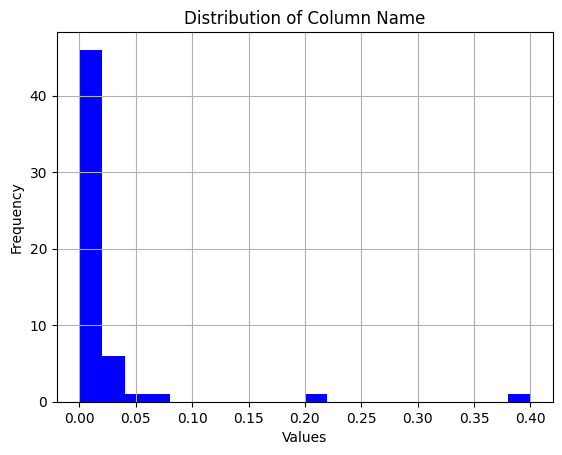

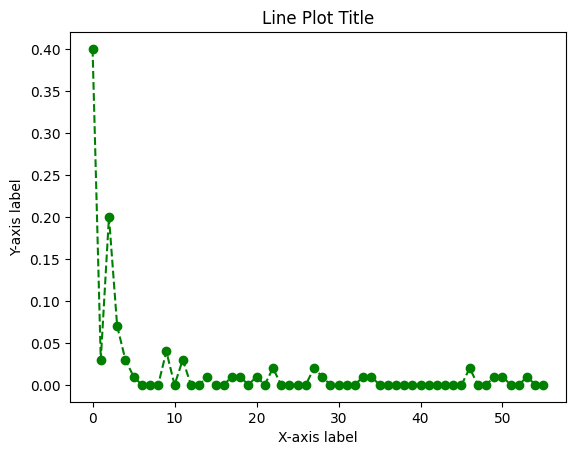

In [25]:

demodf["percentage"].hist(bins=20, color='blue')
plt.title('Distribution of Column Name')
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.show()

demodf["percentage"].plot(linestyle='--', marker='o', color='green')
plt.title('Line Plot Title')
plt.xlabel('X-axis label')
plt.ylabel('Y-axis label')
plt.show()


In [26]:

percentiles = np.percentile(demodf["percentage"], [25, 50, 75])
mean = demodf["percentage"].mean()
std_dev = demodf["percentage"].std()

print('25th percentile: {:.2f}'.format(percentiles[0]))
print('50th percentile (median): {:.2f}'.format(percentiles[1]))
print('75th percentile: {:.2f}'.format(percentiles[2]))
print('Mean: {:.2f}'.format(mean))
print('Standard deviation: {:.2f}'.format(std_dev))




25th percentile: 0.00
50th percentile (median): 0.00
75th percentile: 0.01
Mean: 0.02
Standard deviation: 0.06


In [27]:

uptake.head()

,District,Region,Population,Total House holds,Population densityKms^2,Zonning,Avg Age,literacy rate %,No. of people per house hold,Employment rate,No. of speed tests,tests/populaton,Uptake
0,Kampala,Central,"1,659,600","1,475,813",229,urban,15.9,75%,3.8,69.5,6629.0,0.40%,2.2326
1,Buikwe,Eastern,"456,100","3,965",366.4,town,16.0,75%,4.4,65,155.0,0.03%,0.1899
2,Wakiso,Central,"3,519,300","1,970,859","1,500",urban,17.0,81%,4.0,35,2116.0,0.06%,0.3361
3,Gulu,Northern,"171,878","435,126",89.1,urban,17.0,75%,4.5,67.4,341.0,0.20%,1.1089
4,Mukono,Central,"161,996","585,863",379.1,Mixed,17.0,75%,4.3,66,119.0,0.07%,0.4106


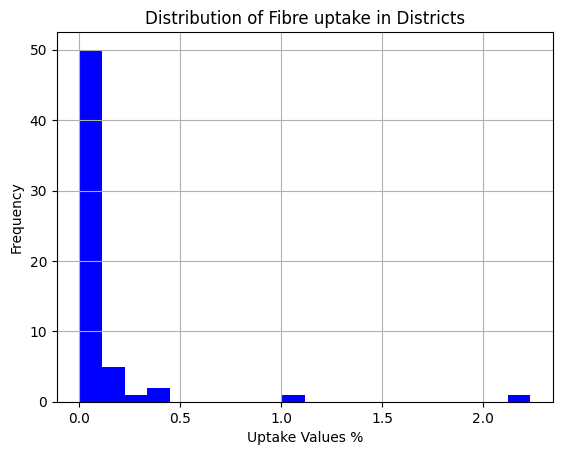

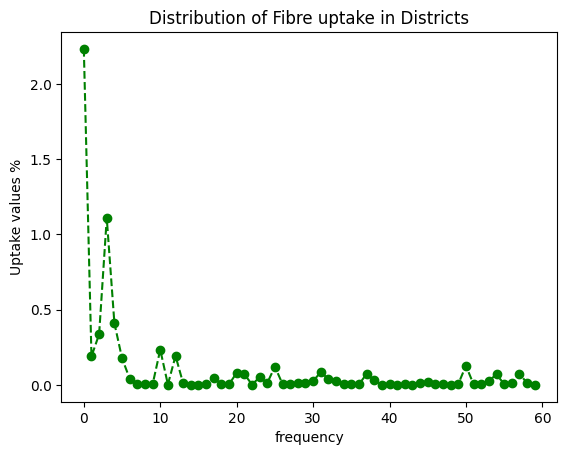

In [28]:
uptake["Uptake"].hist(bins=20, color='blue')
plt.title('Distribution of Fibre uptake in Districts')
plt.xlabel('Uptake Values %')
plt.ylabel('Frequency')
plt.show()

uptake["Uptake"].plot(linestyle='--', marker='o', color='green')
plt.title('Distribution of Fibre uptake in Districts')
plt.xlabel('frequency')
plt.ylabel('Uptake values %')
plt.show()


In [29]:

percentiles = np.percentile(uptake["Uptake"], [25, 50, 75])
mean = uptake["Uptake"].mean()
std_dev = uptake["Uptake"].std()

print('25th percentile: {:.2f}'.format(percentiles[0]))
print('50th percentile (median): {:.2f}'.format(percentiles[1]))
print('75th percentile: {:.2f}'.format(percentiles[2]))
print('Mean: {:.2f}'.format(mean))
print('Standard deviation: {:.2f}'.format(std_dev))


25th percentile: nan
50th percentile (median): nan
75th percentile: nan
Mean: 0.10
Standard deviation: 0.32


In [30]:
uptake.dropna(inplace= True)

In [31]:
uptake.isnull().sum()

District                        0
Region                          0
Population                      0
Total House holds               0
Population densityKms^2         0
Zonning                         0
Avg Age                         0
literacy rate %                 0
No. of people per house hold    0
Employment rate                 0
No. of speed tests              0
tests/populaton                 0
Uptake                          0
dtype: int64

In [32]:
uganda_districts.sample()

,dname2019,Districts,total2020,ttotal2020,2010,2016,2017,2018,2020,geometry
126,RAKAI,Rakai,"317,700",317700.0,RAKAI,RAKAI,RAKAI,RAKAI,RAKAI,"POLYGON ((31.48742 -0.80743, 31.48728 -0.80768..."


In [33]:
# remove special character
uptake.columns = uptake.columns.str.replace(' ', '')

In [34]:
uptake.sample()

,District,Region,Population,TotalHouseholds,PopulationdensityKms^2,Zonning,AvgAge,literacyrate%,No.ofpeopleperhousehold,Employmentrate,No.ofspeedtests,tests/populaton,Uptake
12,Jinja,Eastern,"515,100","115,400",434.7,Mixed,17.0,72.40%,4.5,73.60%,178.0,0.03%,0.1931


In [35]:
uganda_districts.rename(columns= {'d':'District'}, inplace= True)

In [40]:
team_data= uganda_districts.merge(uptake, how= 'right', left_on= 'Districts', right_on= 'District')

In [41]:
team_data.shape

(59, 23)

In [42]:
team_data.dropna(inplace= True)

In [43]:
#save the data
team_data.to_file('uganda_b2.shp', index= None)

/var/folders/tp/0wczdrwd3dg2hbdqrn3gdqm40000gn/T/ipykernel_943/503671037.py:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  team_data.to_file('uganda_b2.shp', index= None)


In [44]:
df=gpd.read_file('uganda_b2.shp')

In [46]:
uganda_districts[uganda_districts['Districts']== 'Wakiso']

,dname2019,Districts,total2020,ttotal2020,2010,2016,2017,2018,2020,geometry
37,WAKISO,Wakiso,"2,915,200",2915200.0,WAKISO,WAKISO,WAKISO,WAKISO,WAKISO,"POLYGON ((32.66313 0.50802, 32.66314 0.50747, ..."


In [47]:
team_data.sample()

,dname2019,Districts,total2020,ttotal2020,2010,2016,2017,2018,2020,geometry,...,TotalHouseholds,PopulationdensityKms^2,Zonning,AvgAge,literacyrate%,No.ofpeopleperhousehold,Employmentrate,No.ofspeedtests,tests/populaton,Uptake
0,KAMPALA,Kampala,"1,680,600",1680600.0,KAMPALA,KAMPALA,KAMPALA,KAMPALA,KAMPALA,"POLYGON ((32.55354 0.34855, 32.55356 0.34860, ...",...,"1,475,813",229,urban,15.9,75%,3.8,69.5,6629.0,0.40%,2.2326


In [48]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [49]:
team_data.crs= 'EPSG:4326'
team_data= team_data.to_crs(4326)

<Axes: >

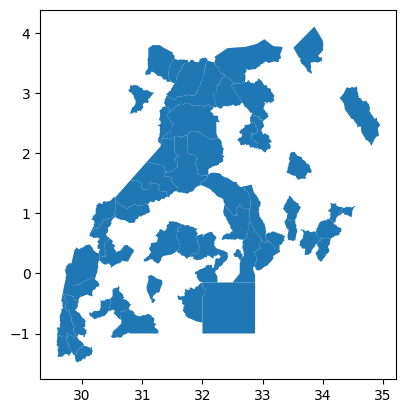

In [50]:
team_data.plot()

In [51]:
linear = cm.LinearColormap(['#7FFF00','green','#EE7621', 'yellow', 'red'],
                           index=[0, 0.1, 0.2, 0.5, 2.0],
                           vmin=0, vmax=2.3)
linear

In [52]:
team_data_n= team_data.set_index('District', drop= False)

In [53]:
uganda_dict = uptake.set_index('District')['Uptake']

In [54]:
# Create overlay of Ookla data and demographic data 
uganda_map = folium.Map(location=[1.3733, 32.2903], zoom_start=7)
# Add Uganda districts to the map
#folium.GeoJson(uganda_districts.to_json()).add_to(uganda_map)




# # style the polygons based on "values" property
# def style_fn(feature):
#     cm = branca.colormap.LinearColormap(["mistyrose", "tomato", "red"], vmin=0, vmax=20)
#     ss = {
#         "fillColor": cm(team_data['Uptake']),
#         "fillOpacity": 0.8,
#         "weight": 0.8,
#         "color": cm(team_data['Uptake']),
#     }
#     return ss

# folium.GeoJson(
#     team_data.__geo_interface__,
#     style_function=style_fn,
#     tooltip=folium.features.GeoJsonTooltip(["District", "Uptake"]),
# ).add_to(uganda_map)





# Add a marker for the capital city Kampala
# folium.Marker(location=[0.3476, 32.5825], tooltip="Kampala").add_to(uganda_map)


# Define the polygon
polygon = wkt.loads(example['geometry'])

# Create a GeoDataFrame with the polygon
gdf = gpd.GeoDataFrame(polygon)

# Convert GeoDataFrame to GeoJSON string
geojson_data = gdf.to_json()

gdf = gpd.GeoDataFrame(example, geometry=gpd.GeoSeries.from_wkt(example['geometry']))

# Define the districts in Q1
q1_districts = ['Soroti', 'Bugiri', 'Iganga', 'Tororo', 'Kagadi', 'Rukungiri', 'Yumbe', 'Moyo', 'Lira', 'Lamwo', 'Kole', 'Kassanda', 'Luwero', 'Pakwach']
q2_districts = ['Bududa', 'Kaliro', 'Hoima', 'Isingiro', 'Kiryandongo', 'Kisoro', 'Sheema', 'Moroto', 'Adjumani', 'Kalangala', 'Karenga', 'Kayunga', 'Lyantonde', 'Mpigi','Mbale', 'Buliisa', 'Kamwenge', 'Kanungu', 'Masindi', 'Mbarara', 'Rubanda', 'Rubirizi', 'Nwoya', 'Amuru', 'Masaka', 'Mityana', 'Mubende', 'Obongi''Kabale', 'Kabarole', 'Kasese', 'Ntoroko', 'Pader', 'Kikuube', 'Nakasongola']
q3_district =['Kampala', 'Buikwe', 'Gulu', 'Mukono', 'Arua', 'Busia', 'Jinja', "Wakiso"]

# Create a map centered on Uganda
uganda_map = folium.Map(location=[1.3733, 32.2903], zoom_start=7)

# Add the polygons to the map and color the polygons in Q1 districts yellow
for index, row in gdf.iterrows():
    if row['District'] in q1_districts:
        folium.GeoJson(row['geometry'], name=row['District'], style_function=lambda x: {'fillColor': 'green', 'color': 'green'}).add_to(uganda_map)
    elif row['District'] in q2_districts:
        folium.GeoJson(row['geometry'], name=row['District'], style_function=lambda x: {'fillColor': 'yellow', 'color': 'yellow'}).add_to(uganda_map)
    elif row['District'] in q3_district:
        folium.GeoJson(row['geometry'], name=row['District'], style_function=lambda x: {'fillColor': 'red', 'color': ' red'}).add_to(uganda_map)


# Add the polygon to the map
#folium.GeoJson(geojson_data).add_to(uganda_map)
folium.GeoJson(
    team_data_n,
    style_function=lambda feature: {
        'fillColor': linear(uganda_dict[feature['id']]),
        'color': 'black',
        'weight': 2,
        'dashArray': '5, 5'
    }
).add_to(uganda_map) 

# Add a marker for each district with a popup showing its name and demographic data
for i, row in demodf.iterrows():
    district = row['District']
    latitude = row['latitude']
    longitude = row['longitude']
    population = row['Population']
    total_households = row['Total House holds']
    density = row['Population densityKms^2']
    zoning = row['Zonning']
    avg_age = row['Avg Age']
    literacy_rate = row['literacy rate %']
    people_per_household = row['No. of people per house hold']
    employment_rate = row['Employment rate']
    speed_tests = row['tests/populaton'] 
    uptake_rate = row['percentage']
    popup_text = f"<b>{district}</b><br>Population: {population}<br>Total Households: {total_households}<br>Population Density: {density}<br>Zonning: {zoning}<br>Avg Age: {avg_age}<br>Literacy Rate: {literacy_rate}<br>People per Household: {people_per_household}<br>Employment Rate: {employment_rate}<br>Speed Tests per Capita: {speed_tests}<br>uptake rate per district: {uptake_rate}"
    popup = folium.Popup(popup_text, max_width=500)
    folium.Marker(location=[latitude, longitude], popup=popup).add_to(uganda_map)

# Add a marker for the capital city Kampala
# folium.Marker(location=[0.3476, 32.5825], tooltip="Kampala").add_to(uganda_map)
folium.GeoJson(uganda_districts.to_json()).add_to(uganda_map)
# Display the map
uganda_map

<a id="four"></a>
## 1.4 Data Engineering
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

# <a id="five"></a>
## 2.1 Modelling
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

<a id="six"></a>
## 2.2 Model Performance
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---

<a id="seven"></a>
## 3.1 Model Explanation and Conclusions
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---